In [69]:
using Distributions, Plots, StatsPlots,Random, StatsBase, LinearAlgebra, JLD2, Measures
using Base:@kwdef
theme(:ggplot2)
include("ChangePoint.jl")
include("VRPF.jl")
include("BlockVRPF.jl")

Main.BlockVRPF

In [29]:
θ = [0.9,1.0,0.75,4.0,10.0]
ξ,y = ChangePoint.SimData(seed=2022)
T = collect(0:50:1000);

Main.ChangePoint.pars(0.9, 1.0, 0.75, 4.0, 10.0)


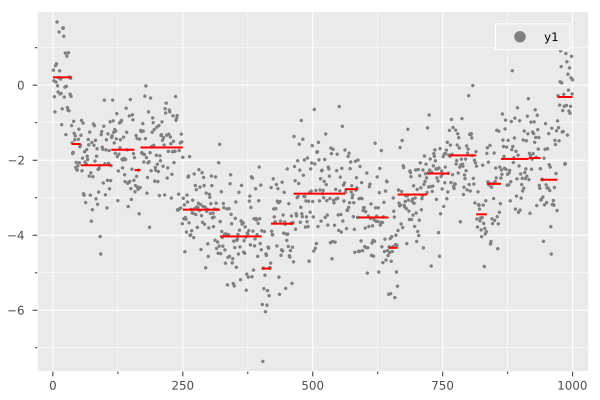

In [7]:
ChangePoint.ProcObsGraph(ξ,y)

# Using BlockVRPF method and only 5 particles. For each particle, the MH is only ran once (NFold=1)


In [74]:
# Global adaptive MCMC
BlockVRPF_RES = BlockVRPF.PG(ChangePoint,y,T,auxpar=[2.0,1.0],method="Global",SMCAdaptN=20,SMCN=5,NFold=1);

┌ Info: Tuning PG parameters...
└ @ Main.BlockVRPF /Users/changzhang/Documents/GitHub/PDMP/BlockVRPF.jl:180
Progress: 100%|█████████████████████████████████████████| Time: 0:11:21
┌ Info: Running PG algorithms...
└ @ Main.BlockVRPF /Users/changzhang/Documents/GitHub/PDMP/BlockVRPF.jl:282
Progress: 100%|█████████████████████████████████████████| Time: 0:03:32


θ0 is[0.9691672584508085, 1.0664802312224584, 0.7758915274765746, 5.3134156958408525, 6.467907759470295]


In [75]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,BlockVRPF_RES[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,BlockVRPF_RES[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

In [44]:
# Global adaptive MCMC
VRPF_RES = VRPF.PG(ChangePoint,y,T,method="Global",SMCAdaptN=20,SMCN=5,NFold=1);

┌ Info: Tuning PG parameters...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:164
Progress: 100%|█████████████████████████████████████████| Time: 0:06:55
┌ Info: Running PG algorithms...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:263
Progress: 100%|█████████████████████████████████████████| Time: 0:02:14


In [56]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,VRPF_RES[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,VRPF_RES[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

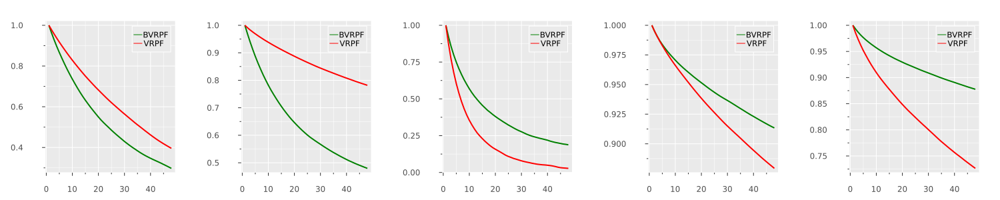

In [76]:
AC_BVRPF = autocor(BlockVRPF_RES);
AC_VRPF = autocor(VRPF_RES);
figure = plot(layout=(1,5),size=(1500,300),margin=6mm)
for i = 1:5
    plot!(figure,AC_BVRPF[:,i],subplot=i,label="BVRPF",color=:green,linewidth=2.0)
    plot!(figure,AC_VRPF[:,i],subplot=i,label="VRPF",color=:red,linewidth=2.0)
end
current()

# Using BlockVRPF method and only 5 particles. For each particle, the MH is only ran 100 times (NFold=100)


In [78]:
# Global adaptive MCMC
BlockVRPF_RES_100Fold = BlockVRPF.PG(ChangePoint,y,T,auxpar=[2.0,1.0],method="Global",SMCAdaptN=100,SMCN=5,NFold=500);

┌ Info: Tuning PG parameters...
└ @ Main.BlockVRPF /Users/changzhang/Documents/GitHub/PDMP/BlockVRPF.jl:180
Progress: 100%|█████████████████████████████████████████| Time: 0:56:56
┌ Info: Running PG algorithms...
└ @ Main.BlockVRPF /Users/changzhang/Documents/GitHub/PDMP/BlockVRPF.jl:282
Progress: 100%|█████████████████████████████████████████| Time: 1:05:43


θ0 is[0.8984134988885581, 0.6678042104967286, 0.7771157014807053, 2.068437916792292, 12.552520452678342]


In [79]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,BlockVRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,BlockVRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

In [81]:
# Global adaptive MCMC
VRPF_RES_100Fold = VRPF.PG(ChangePoint,y,T,method="Global",SMCAdaptN=100,SMCN=5,NFold=500);

┌ Info: Tuning PG parameters...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:164
Progress: 100%|█████████████████████████████████████████| Time: 0:32:56
┌ Info: Running PG algorithms...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:263
Progress: 100%|█████████████████████████████████████████| Time: 1:06:19


In [82]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,VRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,VRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

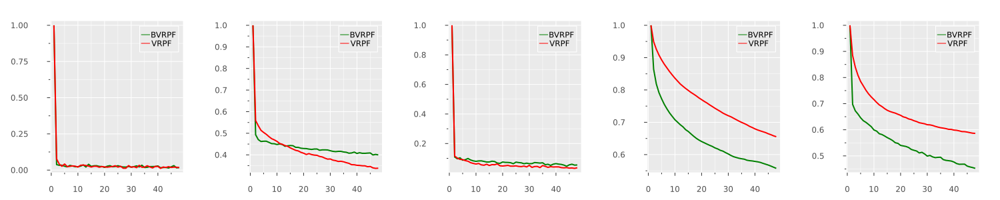

In [83]:
AC_BVRPF = autocor(BlockVRPF_RES_100Fold);
AC_VRPF = autocor(VRPF_RES_100Fold);
figure = plot(layout=(1,5),size=(1500,300),margin=6mm)
for i = 1:5
    plot!(figure,AC_BVRPF[:,i],subplot=i,label="BVRPF",color=:green,linewidth=2.0)
    plot!(figure,AC_VRPF[:,i],subplot=i,label="VRPF",color=:red,linewidth=2.0)
end
current()

In [ ]:
# Global adaptive MCMC
BlockVRPF_RES_100Fold = BlockVRPF.PG(ChangePoint,y,T,auxpar=[2.0,1.0],method="Global",SMCAdaptN=100,SMCN=25,NFold=500);

In [85]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,BlockVRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,BlockVRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

In [86]:
# Global adaptive MCMC
VRPF_RES_100Fold = VRPF.PG(ChangePoint,y,T,method="Global",SMCAdaptN=100,SMCN=25,NFold=500);

┌ Info: Tuning PG parameters...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:164
Progress: 100%|█████████████████████████████████████████| Time: 0:36:17
┌ Info: Running PG algorithms...
└ @ Main.VRPF /Users/changzhang/Documents/GitHub/PDMP/VRPF.jl:263
Progress: 100%|█████████████████████████████████████████| Time: 1:09:03


In [87]:
figure = plot(layout=(2,5),size=(1500,600),margin=6mm)
for n = 1:5
    plot!(figure,VRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=0.5,subplot=n);hline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n)
    density!(figure,VRPF_RES_100Fold[:,n],label="",color=:grey,linewidth=2.0,subplot=n+5);vline!([θ[n]],label="",color=:red,linewidth=2.0,subplot=n+5)
end
current()

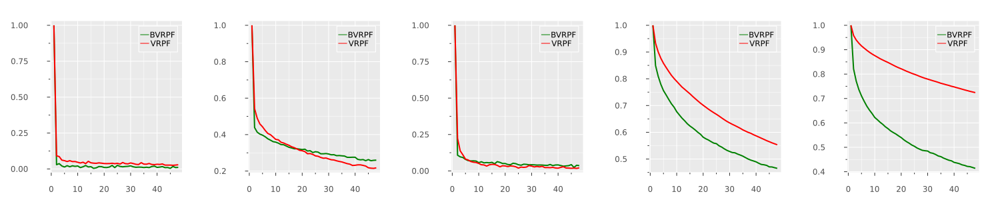

In [88]:
AC_BVRPF = autocor(BlockVRPF_RES_100Fold);
AC_VRPF = autocor(VRPF_RES_100Fold);
figure = plot(layout=(1,5),size=(1500,300),margin=6mm)
for i = 1:5
    plot!(figure,AC_BVRPF[:,i],subplot=i,label="BVRPF",color=:green,linewidth=2.0)
    plot!(figure,AC_VRPF[:,i],subplot=i,label="VRPF",color=:red,linewidth=2.0)
end
current()